### Imports

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.animation as animation

from helpers.method_evaluation import evaluate_limbus, circles_intersection_area, circle_area
from helpers.limbus_detection import detect_circle
from functools import partial

%matplotlib inline
plt.rcParams['animation.html'] = 'jshtml'

%load_ext autoreload
%autoreload 2

### Random frame annotation

In [2]:
methods = ['ground_truth', 'first', 'inout']
results = evaluate_limbus(
    [
        partial(detect_circle, validation='first'),
        partial(detect_circle, validation='inout')
    ],
    'data/annotated/procedure5_annotations_random/',
    append_frame_n=True
)

In [3]:
results.shape

(50, 3, 4)

In [4]:
results_df = pd.DataFrame({
    'frame': list(int(results[i,j,3]) for j in range(results.shape[1]) for i in range(results.shape[0])),
    'method': np.concatenate([[method]*results.shape[0] for method in methods]),
    'radius': list(results[i,j,2] for j in range(results.shape[1]) for i in range(results.shape[0])),
    'center': list(results[i,j,:2] for j in range(results.shape[1]) for i in range(results.shape[0])),
    'radius_abs_diff': np.concatenate([np.abs(results[:,0,2] - results[:,j,2]) for j in range(results.shape[1])]),
    'radius_rel_abs_diff': np.concatenate([np.abs(results[:,0,2] - results[:,j,2]) / results[:,0,2] for j in range(results.shape[1])]),
    'radius_diff': np.concatenate([results[:,j,2] - results[:,0,2] for j in range(results.shape[1])]),
    'radius_rel_diff': np.concatenate([(results[:,j,2] - results[:,0,2]) / results[:,0,2] for j in range(results.shape[1])]),
    'center_offset': np.concatenate([np.linalg.norm(results[:,0,:2] - results[:,j,:2], axis=1) for j in range(results.shape[1])]),
    'circle_inter_area': list(circles_intersection_area(results[i,0,:], results[i,j,:]) for j in range(results.shape[1]) for i in range(results.shape[0])),   
    'circle_inter_area_rel': list(circles_intersection_area(results[i,0,:], results[i,j,:]) / (circle_area(results[i,0,:]) + circle_area(results[i,j,:]) - circles_intersection_area(results[i,0,:], results[i,j,:])) for j in range(results.shape[1]) for i in range(results.shape[0])),   
    
})

/home/miroslav/Documents/tum/Medical Augmented Reality (IN2293)/project/git_root/opencv_explorations/helpers/method_evaluation.py:60: RuntimeWarning: invalid value encountered in double_scalars
  x = (a - b + d**2) / (2 * d)
/home/miroslav/Documents/tum/Medical Augmented Reality (IN2293)/project/git_root/opencv_explorations/helpers/method_evaluation.py:62: RuntimeWarning: invalid value encountered in sqrt
  y = np.sqrt(a - z)


In [5]:
results_df.sample(10)

,frame,method,radius,center,radius_abs_diff,radius_rel_abs_diff,radius_diff,radius_rel_diff,center_offset,circle_inter_area,circle_inter_area_rel
6,2341,ground_truth,151.721443,"[264.6652360515021, 146.96995708154506]",0.000000,0.000000,0.000000,0.000000,0.000000,72317.565975,1.000000
78,8778,first,92.000000,"[339.5, 172.5]",0.334178,0.003646,0.334178,0.003646,2.438375,23952.776171,0.824954
18,6625,ground_truth,100.771582,"[297.7124463519313, 177.87124463519314]",0.000000,0.000000,0.000000,0.000000,0.000000,31902.595920,1.000000
70,7208,first,153.399994,"[344.5, 150.5]",59.069174,0.626192,59.069174,0.626192,22.808608,27954.844980,0.378143
16,4971,ground_truth,152.340566,"[299.0, 179.58798283261802]",0.000000,0.000000,0.000000,0.000000,0.000000,72908.976332,1.000000
82,10131,first,90.500000,"[344.5, 175.5]",0.118941,0.001313,-0.118941,-0.001313,0.893678,21411.199295,0.710926
110,3703,inout,154.199997,"[350.5, 178.5]",1.124843,0.007348,1.124843,0.007348,1.964252,45122.213157,0.437268
130,9446,inout,91.099998,"[344.5, 172.5]",0.368684,0.004031,-0.368684,-0.004031,1.163989,15800.092504,0.432206
66,4971,first,150.399994,"[302.5, 177.5]",1.940572,0.012738,-1.940572,-0.012738,4.075497,30051.433027,0.263792
60,3703,first,152.600006,"[352.5, 177.5]",0.475148,0.003104,-0.475148,-0.003104,1.816686,49228.558974,0.504687


Manual outliers removal

In [6]:
results_df[results_df['radius_abs_diff'] == results_df['radius_abs_diff'].max()]

,frame,method,radius,center,radius_abs_diff,radius_rel_abs_diff,radius_diff,radius_rel_diff,center_offset,circle_inter_area,circle_inter_area_rel
70,7208,first,153.399994,"[344.5, 150.5]",59.069174,0.626192,59.069174,0.626192,22.808608,27954.84498,0.378143


In [7]:
results_df = results_df[results_df.frame != 7208]

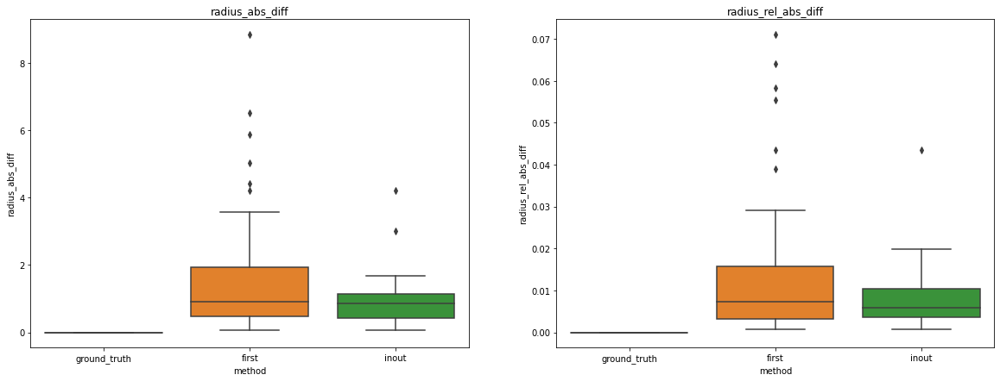

In [8]:
fig, plots = plt.subplots(1, 2, figsize=(20,7))

sns.boxplot(x="method", y="radius_abs_diff", data=results_df, ax=plots[0])
plots[0].set_title('radius_abs_diff')

sns.boxplot(x="method", y="radius_rel_abs_diff", data=results_df, ax=plots[1])
plots[1].set_title('radius_rel_abs_diff')

plt.show()

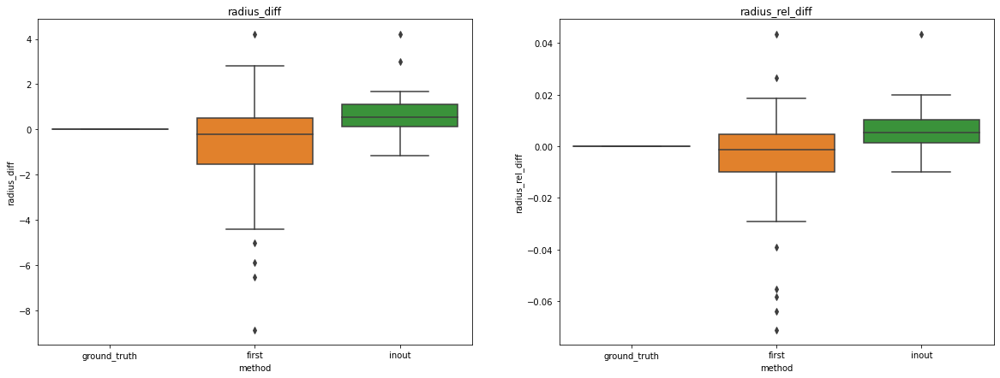

In [9]:
fig, plots = plt.subplots(1, 2, figsize=(20,7))

sns.boxplot(x="method", y="radius_diff", data=results_df, ax=plots[0])
plots[0].set_title('radius_diff')

sns.boxplot(x="method", y="radius_rel_diff", data=results_df, ax=plots[1])
plots[1].set_title('radius_rel_diff')

plt.show()

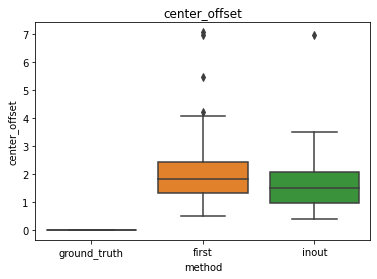

In [10]:
sns.boxplot(x="method", y="center_offset", data=results_df)
plt.title('center_offset')
plt.show()

inter / (ground_circle_area + detected_circle_area - inter)

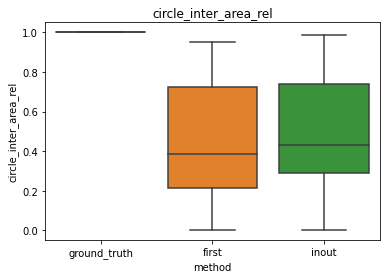

In [11]:
sns.boxplot(x="method", y="circle_inter_area_rel", data=results_df)
plt.title('circle_inter_area_rel')
plt.show()

### Consecutive frame annotation

In [12]:
methods = ['ground_truth', 'first', 'inout']
results = evaluate_limbus(
    [
        partial(detect_circle, validation='first'),
        partial(detect_circle, validation='inout')
    ],
    'data/annotated/procedure5_annotations_consecutive/',
    append_frame_n=True
)

In [13]:
results.shape

(165, 3, 4)

In [14]:
results_df = pd.DataFrame({
    'frame': list(int(results[i,j,3]) for j in range(results.shape[1]) for i in range(results.shape[0])),
    'method': np.concatenate([[method]*results.shape[0] for method in methods]),
    'radius': list(results[i,j,2] for j in range(results.shape[1]) for i in range(results.shape[0])),
    'center': list(results[i,j,:2] for j in range(results.shape[1]) for i in range(results.shape[0])),
    'radius_abs_diff': np.concatenate([np.abs(results[:,0,2] - results[:,j,2]) for j in range(results.shape[1])]),
    'radius_rel_abs_diff': np.concatenate([np.abs(results[:,0,2] - results[:,j,2]) / results[:,0,2] for j in range(results.shape[1])]),
    'radius_diff': np.concatenate([results[:,j,2] - results[:,0,2] for j in range(results.shape[1])]),
    'radius_rel_diff': np.concatenate([(results[:,j,2] - results[:,0,2]) / results[:,0,2] for j in range(results.shape[1])]),
    'center_offset': np.concatenate([np.linalg.norm(results[:,0,:2] - results[:,j,:2], axis=1) for j in range(results.shape[1])]),
    'center_diff': list(results[i,j,:2] - results[i,0,:2] for j in range(results.shape[1]) for i in range(results.shape[0])),
    'circle_inter_area': list(circles_intersection_area(results[i,0,:], results[i,j,:]) for j in range(results.shape[1]) for i in range(results.shape[0])),   
    'circle_inter_area_rel': list(circles_intersection_area(results[i,0,:], results[i,j,:]) / (circle_area(results[i,0,:]) + circle_area(results[i,j,:]) - circles_intersection_area(results[i,0,:], results[i,j,:])) for j in range(results.shape[1]) for i in range(results.shape[0])),   
    
})

/home/miroslav/Documents/tum/Medical Augmented Reality (IN2293)/project/git_root/opencv_explorations/helpers/method_evaluation.py:60: RuntimeWarning: invalid value encountered in double_scalars
  x = (a - b + d**2) / (2 * d)
/home/miroslav/Documents/tum/Medical Augmented Reality (IN2293)/project/git_root/opencv_explorations/helpers/method_evaluation.py:62: RuntimeWarning: invalid value encountered in sqrt
  y = np.sqrt(a - z)


In [15]:
results_df.sample(10)

,frame,method,radius,center,radius_abs_diff,radius_rel_abs_diff,radius_diff,radius_rel_diff,center_offset,center_diff,circle_inter_area,circle_inter_area_rel
406,3900,inout,153.300003,"[352.5, 174.5]",0.475103,0.003109,0.475103,0.003109,1.200685,"[-1.103603603603574, -0.47297297297293994]",54370.371288,0.585678
430,3924,inout,152.600006,"[350.5, 175.5]",0.219203,0.001439,0.219203,0.001439,3.148033,"[-3.103603603603574, 0.5270270270270601]",69332.172096,0.903082
177,3836,first,152.300003,"[337.5, 172.5]",0.368148,0.002411,-0.368148,-0.002411,1.870460,"[1.0135135135135442, -1.5720720720720465]",54859.493109,0.601308
366,3860,inout,152.399994,"[340.5, 173.5]",0.251060,0.001650,0.251060,0.001650,2.141464,"[-0.9414414414413841, -1.923423423423401]",67072.094215,0.853124
309,3968,first,153.300003,"[352.5, 175.5]",0.554786,0.003632,0.554786,0.003632,1.222987,"[-1.103603603603574, 0.5270270270270601]",51346.089357,0.536078
47,3871,ground_truth,152.593705,"[354.054054054054, 174.07207207207205]",0.000000,0.000000,0.000000,0.000000,0.000000,"[0.0, 0.0]",73151.478806,1.000000
22,3846,ground_truth,152.044877,"[337.3873873873874, 172.7207207207207]",0.000000,0.000000,0.000000,0.000000,0.000000,"[0.0, 0.0]",72626.222669,1.000000
139,3963,ground_truth,153.025914,"[352.70270270270265, 175.4234234234234]",0.000000,0.000000,0.000000,0.000000,0.000000,"[0.0, 0.0]",73566.456652,1.000000
149,3973,ground_truth,153.219382,"[353.6036036036036, 175.87387387387386]",0.000000,0.000000,0.000000,0.000000,0.000000,"[0.0, 0.0]",73752.591109,1.000000
92,3916,ground_truth,153.017958,"[353.15315315315314, 174.97297297297294]",0.000000,0.000000,0.000000,0.000000,0.000000,"[0.0, 0.0]",73558.807291,1.000000


In [16]:
results_df.frame.min(), results_df.frame.max()

(3824, 3988)

### Smoothing evaluation

In [1]:
center_offset_max = np.ceil(results_df[results_df['method'] == 'inout']['center_offset'].max())
center_diffs_inout = results_df[results_df['method'] == 'inout'].sort_values('frame')['center_diff'].values
center_diffs_inout = np.vstack(center_diffs_inout)

fig, plots = plt.subplots(1, 1, figsize=(10,10))
plots = [plots]

plots[0].plot(center_diffs_inout[:,0], center_diffs_inout[:,1])
plots[0].set_xlim(-center_offset_max, center_offset_max)
plots[0].set_ylim(-center_offset_max, center_offset_max)
plots[0].set_title('radius_diff')

for i in range(center_diffs_inout.shape[0]):
    plots[0].annotate(str(i), (center_diffs_inout[i,0], center_diffs_inout[i,1]))

plt.show()



NameError: name 'np' is not defined

In [18]:
center_offset_max = np.ceil(results_df[results_df['method'] == 'inout']['center_offset'].max())

center_ground_truth = results_df[results_df['method'] == 'ground_truth'].sort_values('frame')['center'].values.copy()
center_ground_truth = np.vstack(center_ground_truth)

center_diffs_inout = results_df[results_df['method'] == 'inout'].sort_values('frame')['center_diff'].values.copy()
center_diffs_inout = np.vstack(center_diffs_inout)

center_diffs_inout_smoothed_5 = results_df[results_df['method'] == 'inout'].sort_values('frame')['center'].values.copy()
center_diffs_inout_smoothed_5 = np.vstack(center_diffs_inout_smoothed_5)
center_diffs_inout_smoothed_5[:,0] = np.convolve(center_diffs_inout_smoothed_5[:,0], 
                                               np.ones(5)/5, mode='same')
center_diffs_inout_smoothed_5[:,1] = np.convolve(center_diffs_inout_smoothed_5[:,1], 
                                               np.ones(5)/5, mode='same')
center_diffs_inout_smoothed_5 -= center_ground_truth

center_diffs_inout_smoothed_10 = results_df[results_df['method'] == 'inout'].sort_values('frame')['center'].values.copy()
center_diffs_inout_smoothed_10 = np.vstack(center_diffs_inout_smoothed_10)
center_diffs_inout_smoothed_10[:,0] = np.convolve(center_diffs_inout_smoothed_10[:,0], 
                                               np.ones(10)/10, mode='same')
center_diffs_inout_smoothed_10[:,1] = np.convolve(center_diffs_inout_smoothed_10[:,1], 
                                               np.ones(10)/10, mode='same')
center_diffs_inout_smoothed_10 -= center_ground_truth

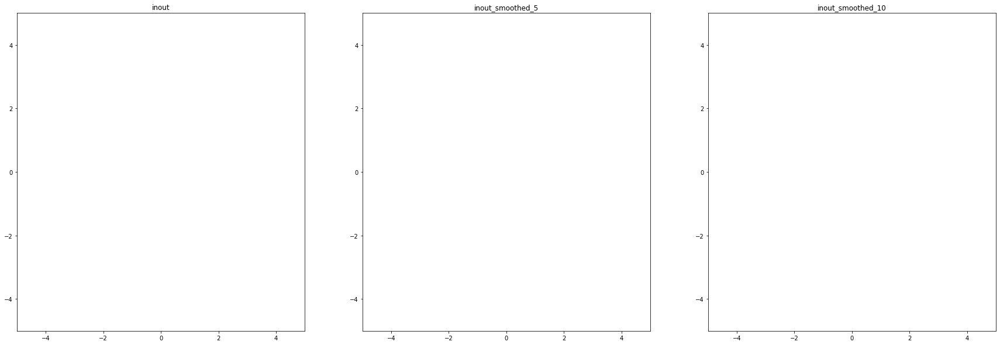

In [19]:
fig, plots = plt.subplots(1, 3, figsize=(30,10))
# plots = [plots]

line_inout, = plots[0].plot([], [])
plots[0].set_xlim(-center_offset_max, center_offset_max)
plots[0].set_ylim(-center_offset_max, center_offset_max)
plots[0].set_title('inout')

line_inout_smoothed_5, = plots[1].plot([], [])
plots[1].set_xlim(-center_offset_max, center_offset_max)
plots[1].set_ylim(-center_offset_max, center_offset_max)
plots[1].set_title('inout_smoothed_5') 

line_inout_smoothed_10, = plots[2].plot([], [])
plots[2].set_xlim(-center_offset_max, center_offset_max)
plots[2].set_ylim(-center_offset_max, center_offset_max)
plots[2].set_title('inout_smoothed_10') 

# for i in range(center_diffs_inout.shape[0]):
#     plots[0]annotate(str(i), (center_diffs_inout[i,0], center_diffs_inout[i,1]))

def animate(i):
    line_inout.set_data(
        center_diffs_inout[:i % center_diffs_inout.shape[0], 0],
        center_diffs_inout[:i % center_diffs_inout.shape[0], 1]
    )
    line_inout_smoothed_5.set_data(
        center_diffs_inout_smoothed_5[:i % center_diffs_inout_smoothed_5.shape[0], 0],
        center_diffs_inout_smoothed_5[:i % center_diffs_inout_smoothed_5.shape[0], 1]
    )
    line_inout_smoothed_10.set_data(
        center_diffs_inout_smoothed_10[:i % center_diffs_inout_smoothed_10.shape[0], 0],
        center_diffs_inout_smoothed_10[:i % center_diffs_inout_smoothed_10.shape[0], 1]
    )

anim = animation.FuncAnimation(fig, animate, frames=center_diffs_inout.shape[0])

In [20]:
anim

Animation size has reached 21019980 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [21]:
center_offset_df = pd.DataFrame({
    'method': ['inout']*center_diffs_inout.shape[0] + \
              ['inout_smoothed_5']*center_diffs_inout_smoothed_5.shape[0] + \
              ['inout_smoothed_10']*center_diffs_inout_smoothed_10.shape[0],
    'offset': np.concatenate((np.linalg.norm(center_diffs_inout, axis=1),
                              np.linalg.norm(center_diffs_inout_smoothed_5, axis=1),
                              np.linalg.norm(center_diffs_inout_smoothed_10, axis=1)))
})

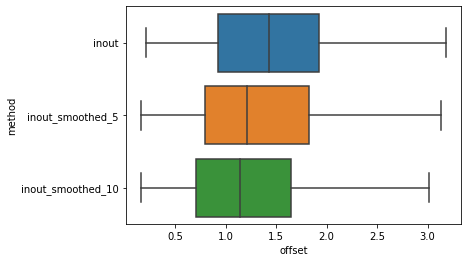

In [22]:
sns.boxplot(data=center_offset_df, x='offset', y='method', showfliers=False)
plt.show()